In [9]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import IPython.display as ipd

from util import get_audio, normalize, set_audio, denormalize, slice_data
%matplotlib inline

In [3]:
song = 'intro_x'
path = '/home/ksooklall/Music/wav/{}.wav'

In [6]:
rate, data = get_audio(path.format(song))

In [29]:
data.shape

(5645087,)

In [11]:
ipd.Audio(path.format(song))

In [4]:
data.shape

(5645087,)

In [27]:
data.shape

(5645087,)

In [13]:
sdata = slice_data(data, pct=0.8)
set_audio('intro_x_0.8.wav', rate, sdata)

0

In [14]:
ipd.Audio('intro_x_0.8.wav')

In [16]:
sdata.shape

(3387052,)

In [18]:
def plot_wav(data):
    plt.plot(data)
    plt.ylabel('Frequency [Hz]')
    plt.xlabel('Time [sec]')
    plt.show()

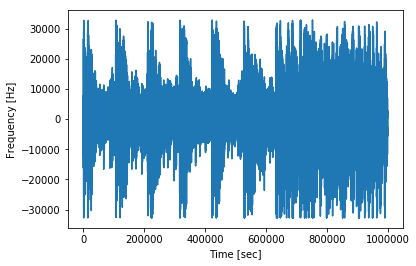

In [19]:
plot_wav(sdata[:1000000])

Deep Learning to Generate Audio with VAE

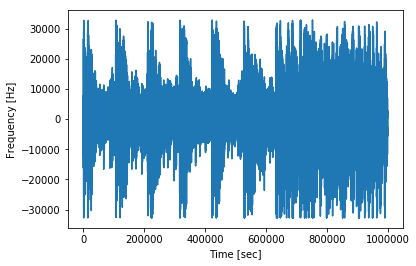

In [22]:
plot_wav(gd[:1000000])

In [25]:
from keras import backend as K
from keras.layers import Input, Dense, Dropout, Lambda
from keras.layers.normalization import BatchNormalization
from keras.models import Model
from keras.utils import plot_model
from keras.callbacks import ModelCheckpoint, ReduceLROnPlateau
from keras import optimizers
from keras.losses import binary_crossentropy, mse

Using TensorFlow backend.


In [ ]:
# Inputs
X, X_max, X_min = normalize(sdata)
X_train = X.reshape(16442, original_dim)

In [237]:
# Hyper parameters
original_dim = 206
input_shape = (original_dim,)
intermediate_dim = 512
latent_dim = 30
batch_size=128
epochs=100
learning_rate=0.001

In [238]:
def sampling(args):
    z_mean, z_var = args
    batch = K.shape(z_mean)[0]
    dim = K.int_shape(z_mean)[1]
    esp = K.random_normal(shape=(batch, dim))
    return z_mean + K.exp(0.5 * z_var) * esp

In [239]:
def vae(X):
    inputs = Input(shape=input_shape)
    x = Dense(intermediate_dim, activation='relu')(inputs)
    x = BatchNormalization()(x)
    z_mean = Dense(latent_dim)(x)
    z_var = Dense(latent_dim)(x)
    z = Lambda(sampling, output_shape=(latent_dim,))([z_mean, z_var])
    
    encoder = Model(inputs, [z_mean, z_var, z], name='encoder')
    encoder.summary()
    
    latent_inputs = Input(shape=(latent_dim,))
    x = Dense(intermediate_dim, activation='relu')(latent_inputs)
    x = BatchNormalization()(x)
    outputs = Dense(original_dim, activation='sigmoid')(x)
    
    decoder = Model(latent_inputs, outputs, name='decoder')
    decoder.summary()

    outputs = decoder(encoder(inputs)[2])
    vae = Model(inputs, outputs, name='vae')
    vae.summary()
    return vae, encoder, decoder, z_var, z_mean, outputs, inputs

In [240]:
vae, encoder, decoder, z_var, z_mean, outputs, inputs = vae(X_train)

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_41 (InputLayer)           (None, 206)          0                                            
__________________________________________________________________________________________________
dense_118 (Dense)               (None, 512)          105984      input_41[0][0]                   
__________________________________________________________________________________________________
batch_normalization_21 (BatchNo (None, 512)          2048        dense_118[0][0]                  
__________________________________________________________________________________________________
dense_119 (Dense)               (None, 30)           15390       batch_normalization_21[0][0]     
__________________________________________________________________________________________________
dense_120 

In [241]:
# Loss
reconstruction_loss = mse(inputs, outputs)
reconstruction_loss *= original_dim # Not sure why we do this step
kl_loss = - 0.5 * K.sum(1 + z_var - K.square(z_mean) - K.exp(z_var), axis=-1)
vae_loss = K.mean(reconstruction_loss + kl_loss)

vae.add_loss(vae_loss)

In [242]:
# Optimizer
reduce_lr = ReduceLROnPlateau(monitor='loss', factor=0.2, patience=5, min_lr=0.001)
optimizer = optimizers.Adam(lr=learning_rate, beta_1=0.9, beta_2=0.999, epsilon=None, decay=0.0, amsgrad=False)
vae.compile(optimizer=optimizer)

In [243]:
# Train
history = vae.fit(X_train, batch_size=batch_size, epochs=epochs, callbacks=[reduce_lr])

Epoch 1/100
16442/16442 [==============================] - 3s 177us/step - loss: 7.2832
Epoch 2/100
16442/16442 [==============================] - 1s 52us/step - loss: 4.1851
Epoch 3/100
16442/16442 [==============================] - 1s 53us/step - loss: 3.7167
Epoch 4/100
16442/16442 [==============================] - 1s 53us/step - loss: 3.5414
Epoch 5/100
16442/16442 [==============================] - 1s 51us/step - loss: 3.4719
Epoch 6/100
16442/16442 [==============================] - 1s 53us/step - loss: 3.4221
Epoch 7/100
16442/16442 [==============================] - 1s 53us/step - loss: 3.4092
Epoch 8/100
16442/16442 [==============================] - 1s 54us/step - loss: 3.3692
Epoch 9/100
16442/16442 [==============================] - 1s 57us/step - loss: 3.3839
Epoch 10/100
16442/16442 [==============================] - 1s 55us/step - loss: 3.3572
Epoch 11/100
16442/16442 [==============================] - 1s 54us/step - loss: 3.3471
Epoch 12/100
16442/16442 [==============

16442/16442 [==============================] - 1s 53us/step - loss: 3.1575
Epoch 95/100
16442/16442 [==============================] - 1s 56us/step - loss: 3.1317
Epoch 96/100
16442/16442 [==============================] - 1s 55us/step - loss: 3.1320
Epoch 97/100
16442/16442 [==============================] - 1s 54us/step - loss: 3.1526
Epoch 98/100
16442/16442 [==============================] - 1s 55us/step - loss: 3.1430
Epoch 99/100
16442/16442 [==============================] - 1s 53us/step - loss: 3.1601
Epoch 100/100
16442/16442 [==============================] - 1s 55us/step - loss: 3.1453


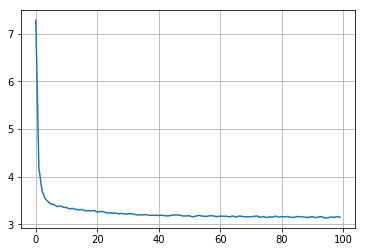

In [244]:
def plot_training(hist):
    plt.plot(hist.history['loss'])
    plt.grid()
plot_training(history)

In [245]:
# Predict
pred = vae.predict(X_train[:10000], batch_size=batch_size)
pred = denormalize(pred.flatten(), X_max, X_min)
set_audio('intro_x_pred.wav', rate, pred)

0

Just a lot of static

In [246]:
ipd.Audio('intro_x_pred.wav')

In [247]:
rate, pdata = get_audio('intro_x_pred.wav')

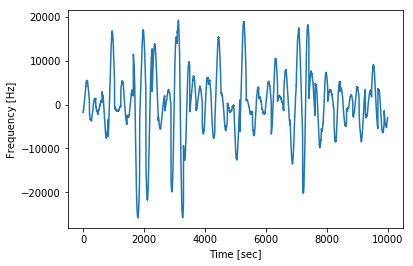

In [248]:
plot_wav(pdata[:10000])

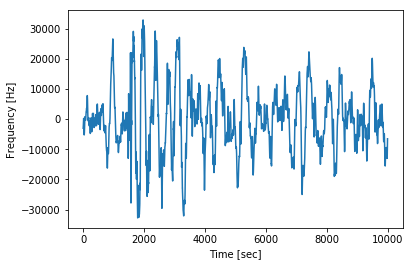

In [249]:
plot_wav(sdata[:10000])